Before you turn this problem in, make sure everything runs as expected. First, **restart the kernel** (in the menubar, select Kernel$\rightarrow$Restart) and then **run all cells** (in the menubar, select Cell$\rightarrow$Run All).

Make sure you fill in any place that says `YOUR CODE HERE` or "YOUR ANSWER HERE", as well as your name and collaborators below:

In [ ]:
NAME = "Jan Wirth"
COLLABORATORS = "Björn-Uwe Steinorth"

---

# Schiebe-Puzzle (40 Punkte)

Sie kennen sicherlich das Schiebepuzzle, bei dem man eine zufällige Ausgangsstellung sortieren muss, indem man in jedem Zug ein Zahlenfeld auf die Lücke verschiebt:  

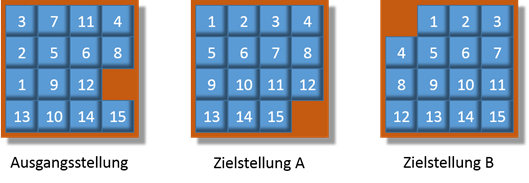


Es gibt $16! ≈ 2.1*10^{13}$ Ausgangsstellungen. Genau die Hälfte davon können in die Zielstellung A, die andere Hälfte in die Zielstellung B überführt werden, aber keine in beide. Die Stellung links lässt sich in 19 Zügen nach A transformieren. Für die schwierigsten Stellungen benötigt man 80 Züge bis zum Ziel. Mit einem einfachen Python-Programm wie in dieser Aufgabe kann man in akzeptabler Zeit Lösungswege mit bis zu 20 Zügen finden.     

a) **(3 Points)**  
Die aktuelle Stellung wird in einem Array der Länge 16 repräsentiert, das die Zahlen und das Leerzeichen enthält. Schreiben Sie eine Funktion ***print_pos(p)***, die die Stellung p formatiert auf die Konsole ausgibt:  

```python
>>> p = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ' ']   
>>> print_pos(p)   # penthält hier die Zielstellung A  
"""
 1  2  3  4  
 5  6  7  8  
 9 10 11 12  
13 14 15
"""
```


In [2]:
def print_pos(p):
    """
    The function receives an array of length 16 containing the numbers and the space
    and prints it in the format of puzzle square. 
    
    Arguments:
    p -- an array of length 16 containing the numbers and the space, 
    for example p = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ' ']
    """
    lines = []
    for idx, val in enumerate(p):
        if idx % 4 == 0:
            line = list()
            lines.append(line)
        cell = "% 3d" % (val,) if isinstance(val, int) else "   "
        line.append(cell)
    [print(' '.join(line)) for line in lines]


In [3]:
start = [3,7,11,4,2,5,6,8,1,9,12,'',13,10,14,15]
A = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ' ']
B = [' ', 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15]
print('-------- start --------')
print_pos(start)
print('-------- A --------')
print_pos(A)
print('-------- B --------')
print_pos(B)

-------- start --------
  3   7  11   4
  2   5   6   8
  1   9  12    
 13  10  14  15
-------- A --------
  1   2   3   4
  5   6   7   8
  9  10  11  12
 13  14  15    
-------- B --------
      1   2   3
  4   5   6   7
  8   9  10  11
 12  13  14  15


b) **(12 Punkte)**  
Erzeugen Sie lösbare Ausgangsstellungen, indem Sie die Zielstellung A mittels Zufallszahlen verwürfeln. Schreiben Sie eine Funktion `shuffle_pos(N)`, die von Zielstellung A beginnend N zufällige Züge ausführt und die resultierende Stellung zurückgibt. Die möglichen Züge "up" (verschiebe das Feld unterhalb der Lücke nach oben), "left" (verschiebe das Feld rechts der Lücke nach links), "down" und "right" werden dabei durch Zufallszahlen 0…3 ausgewählt. Wenn die Lücke sich am Rand des Spielfelds befindet, sind allerdings nicht alle Züge erlaubt (in Stellung A sind z.B. nur "right" und "down" möglich). Lösen Sie dieses Problem durch *rejection sampling*: Wenn die gewählte Zufallszahl einen unerlaubten Zug bezeichnet, wird sie ignoriert und eine neue gezogen. Ignorieren Sie gleichfalls Zufallszahlen, die den vorhergehenden Zug wieder rückgängig machen (es ist also z.B. verboten, nach "up" sofort "down" auszuführen).

**Hinweis:**
Um den Test zu erfüllen müssen Sie den Anweisungen genau Folge leisten. Benutzen Sie `random.randint(0, 3)` um Zufallszahlen zu generieren.

In [9]:
import random
from random import randrange

# invalid move because out of boundary
def move_ok(pos,move):
    if (pos < 4      and move == 2):
        return False
    if (pos >= 12    and move == 0):
        return False
    if (pos % 4 == 0 and move == 3):
        return False
    if (pos % 4 == 3 and move == 1):
        return False
    return True

# move piece of puzzle
def move_piece(p,pos,move):
    if (move == 0):
        # up
        p[pos], p[pos+4] = p[pos+4],p[pos]
        return p,pos+4
    elif (move == 1):
        # left
        p[pos], p[pos+1] = p[pos+1],p[pos]
        return p,pos+1
    elif (move == 2):
        # down
        p[pos], p[pos-4] = p[pos-4],p[pos]
        return p,pos-4
    else: # (move == 3)
        # right
        p[pos], p[pos-1] = p[pos-1],p[pos]
        return p,pos-1

def shuffle_pos(N):
    # inital field
    A = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ' ']
    # empty pos
    pos = 15
    # next move is first move, so no prev move
    previous = 8
    # shuffle N times
    for i in range(N):
        move = randrange(4)
        # make sure that move is new and valid
        while (abs(move - previous) == 2 or not move_ok(pos,move)):
            move = randrange(4)
        # remember current move
        previous = move
        # perform move
        A,pos = move_piece(A,pos,move)
    # initial position A
    return A

In [10]:
random.seed(1)
assert shuffle_pos(1) == [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, ' ', 13, 14, 15, 12]
assert shuffle_pos(2) == [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, ' ', 14, 15]
assert shuffle_pos(3) == [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, ' ', 13, 14, 15]
assert shuffle_pos(4) == [1, 2, 3, 4, 5, 6, 7, 8, ' ', 10, 11, 12, 9, 13, 14, 15]
assert shuffle_pos(5) == [1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 10, 11, 13, 15, ' ', 12]

random.seed(2)
assert shuffle_pos(1) == [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, ' ', 13, 14, 15, 12]
assert shuffle_pos(2) == [1, 2, 3, 4, 5, 6, 7, ' ', 9, 10, 11, 8, 13, 14, 15, 12]
assert shuffle_pos(3) == [1, 2, 3, 4, 5, 6, 7, 8, 9, ' ', 11, 12, 13, 10, 14, 15]
assert shuffle_pos(4) == [1, 2, 3, 4, 5, ' ', 6, 8, 9, 10, 7, 12, 13, 14, 11, 15]
assert shuffle_pos(5) == [1, 2, 3, 4, 5, 6, 7, 8, 9, 14, 10, 11, 13, 15, ' ', 12]

c)	**(25 Points)**  
Man kann die kürzeste Zugfolge zum Ziel mittels Breitensuche finden. Dabei bezeichnet jeder Knoten des Graphen eine Stellung. Stellungen, die durch einen einzigen Zug ineinander übergehen, werden durch Kanten verbunden. Allerdings kann man diesen Graphen nicht vollständig erzeugen, weil er mit 16! Knoten viel zu groß wäre. Deshalb muss der Standardalgorithmus aus der Vorlesung modifiziert werden:  
> *	Man erzeugt die Knoten des Graphen *on the fly*, also erst dann, wenn sie in der Schleife über die Nachbarn tatsächlich benötigt werden. Die Suche wird bei einer gegebenen Suchtiefe abgebrochen, falls bis dahin keine Lösung gefunden wurde.  
  
> * Das Array `parents` muss jetzt vom Typ `dict` sein und enthält anfangs nur die Ausgangsstellung. Wird eine Stellung p erstmals erreicht, legt man für sie einen Eintrag in `parents` an. Als Schlüssel wird dabei die Stringdarstellung `str(p)` verwendet (`p` kann nicht direkt als Schlüssel dienen, weil Python für Arrays keine Hashfunktion definiert). Der zugehörige Wert ist der Vaterknoten, also die Stellung, von wo aus der aktuelle Knoten erreicht wurde (dies ist nützlich, um am Ende den Lösungsweg zurückverfolgen und ausdrucken zu können). **Alterntiv können Sie ein zusätzliches Feld oder eine zusätzliche Liste verwenden um alle besuchten Positionen zu speichern und diese später auszugeben.**  

Implementieren Sie die Funktion `solve_pos(p, maxmove)`, die nach Lösungen mit maximal `maxmove` Zügen sucht. Wird eine Lösung gefunden, sollen die Anzahl der Züge und der Lösungsweg ausgedruckt werden, also alle Stellungen von der Ausgangsstellung bis zum Ziel. Andernfalls wird nur die Ausgangsstellung mit der Bemerkung **"unsolved"** ausgedruckt. Testen Sie, dass für die Ausgangsstellung im obigen Bild tatsächlich 19 Züge benötigt werden. Erzeugen Sie mit der Funktion `shuffle_pos()` aus b) weitere Ausgangsstellungen und geben Sie die Lösungen dafür aus.

In [7]:
from collections import deque     # You may need to use queue data structure.
from copy import deepcopy         # You may need to use deep copy.


def do_next_safe(last: str, A: list, move_id: int):
    # print('move_id', move_id)
    directions = ["up", "left", "down", "right"]
    move = directions[move_id]
    # shuffled enuff
    # we can actually do dis
    if is_allowed_move(last, move, A):
        # print('exec', move)
        res = execute(move, A[:])
        # print(A, res)
        return res # copy before return

    
def next_nodes(last_step, current_node):
    possible = [do_next_safe(last_step, current_node, move) for move in range(0, 4)]
    return list(filter(lambda res: res is not None, possible))
        
        
TARGET = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ' ']
    

def solve_pos(p, maxmove):
    """
    The function looks for solutions with maximum 'maxmove' moves, for a puzzle starts with the position 'p' targeted at
    A = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, ' ']. 
    The function prints all the positions at each move, and returns the total number of moves.
    
    Arguments:
    p -- an array of length 16 containing the numbers and the space, which is the starting position
    maxmove -- maximum number of moves allowed
    
    Returns:
    move -- total number of moves
    
    """
    print('moves left', maxmove)
    # YOUR CODE HERE
    if maxmove <= 0:
        return False
    res = next_nodes(None, p)
    # print(res)
    # print(p)
    # print(TARGET)
    if TARGET in res:
        return True
    else:
        print('TERMINABLE')
        return True in list(map(lambda p: solve_pos(p, maxmove - 1), res))
    
    

solve_pos(shuffle_pos(3), 3)
# YOUR CODE HERE

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

True

In [8]:
import time
import random
random.seed(123)

p = shuffle_pos(4)
start = time.clock()
assert solve_pos(p, 20) == 4
end = time.clock()
print('CPU time: %.2f ms'%((end-start)*1000))

p = shuffle_pos(8)
start = time.clock()
assert solve_pos(p, 20) == 8
end = time.clock()
print('CPU time: %.2f ms'%((end-start)*1000))

p = [3, 7, 11, 4, 2, 5, 6, 8, 1, 9, 12, ' ', 13, 10, 14, 15]
start = time.clock()
assert solve_pos(p, 20) == 19
end = time.clock()
print('CPU time: %.2f ms'%((end-start)*1000))


moves left 20
TERMINABLE
moves left 19
TERMINABLE
moves left 18
TERMINABLE
moves left 17
TERMINABLE
moves left 16
TERMINABLE
moves left 15
TERMINABLE
moves left 14
TERMINABLE
moves left 13
TERMINABLE
moves left 12
TERMINABLE
moves left 11
TERMINABLE
moves left 10
TERMINABLE
moves left 9
TERMINABLE
moves left 8
TERMINABLE
moves left 7
TERMINABLE
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves l

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE


moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE


moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2


moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABL

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves l

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves l

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABL

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
move

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1


moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 8
TERMINABLE
moves left 7
TERMINABLE
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
move

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves l

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE


TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
mo

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1


moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
mo

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves l

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0


TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves l

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves l

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 7
TERMINABLE
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
move

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 7
TERMINABLE
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TE

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
move

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1


TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABL

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
mo

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMI

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABL

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMI

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1


moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 7
TERMINABLE
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0


moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE


TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINA

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TE

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves l

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves l

moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE


TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TE

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINA

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
mo

moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABL

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINA

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2


TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2


moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
move

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TE

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves l

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1


moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves l

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TE

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
mo

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
mo

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
mo

moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves l

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE


TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
move

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TE

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves lef

moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
mo

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TE

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TE

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 7
TERMINABLE
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TE

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABL

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 8
TERMINABLE
moves left 7
TERMINABLE
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERM

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMI

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1


moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE


moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
mo

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves l

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINA

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1


moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABL

TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE


TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves lef

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves l

moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0


TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves lef

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0


moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves l

moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINA

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1


moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINA

moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves lef

TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
mo

moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 

moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 6
TERMINABLE
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0


moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABL

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 5
TERMINABLE
moves left 4
TERMINABLE
moves lef

TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 4
TERMINABLE
moves left 3
TERMINABLE
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves lef

moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 2
TERMINABLE
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves left 0
moves left 0
moves left 1
TERMINABLE
moves left 0
moves left 0
moves l

KeyboardInterrupt: 